<a href="https://colab.research.google.com/github/diegormsouza/vlmg-11/blob/main/VLMG_11_SENTINEL_2_Online_Notebook_Demonstration.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

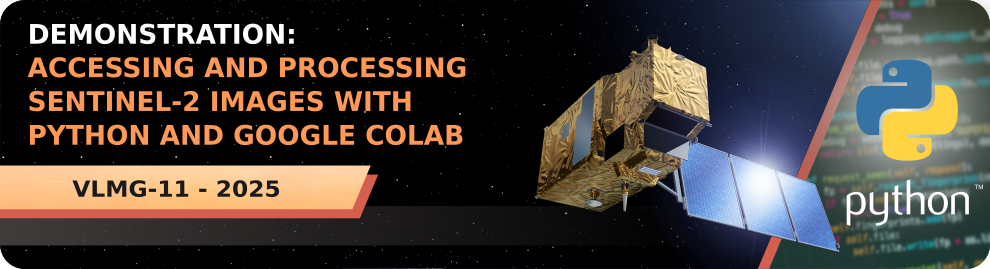

**Author:** Diego Souza (https://github.com/diegormsouza/vlmg-11) - INPE / CGCT / DISSM (VLab CoE Brazil)

**Contributors:** Marcial Garbanzo (UCR - VLab CoE Costa Rica) / Inés Leyba (DCAO - VLab CoE Argentina)

**References:**

https://stacspec.org/en/tutorials/access-sentinel-2-data-aws/

https://gist.github.com/alexgleith/dc49156aab4b9270b0a0f145bd7fa0ce

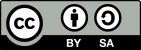

# **Step 1: Installing the Required Python Libraries**

Google Colab comes with several Python libraries pre-installed. In this first step, we will install the additional Python libraries required to run the examples. These libraries include:

*   **cartopy:** a package used for creating maps and performing geospatial data analysis.
*   **pystac-client:** a Python library for interacting with STAC Catalogs and APIs that conform to the STAC and STAC API specifications.
*   **odc-stac:** a tool for loading STAC items into xarray Datasets, enabling local or distributed data loading and computation using Dask.
*   **pyspectral:** a library to read and manipulate satellite sensor spectral responses and solar irradiance spectra.
*   **ipympl:** an extension for enabling interactive features of matplotlib

**Note:**
You only need to run this cell once.



In [4]:
# install the required libraries
!pip install cartopy pystac-client odc-stac pyspectral ipympl -q

# create a directory to save the PNGs
!mkdir -p output

# **Step 2: Importing the Required Modules**

In this step, we will import the libraries that were installed in the previous step.

**Note:** You only need to run this cell once.

In [5]:
# importing the required modules

import numpy as np                    # python library used for working with arrays
import cartopy, cartopy.crs as ccrs   # produce maps and other geospatial data analyses
import matplotlib.pyplot as plt       # plotting library
from pystac_client import Client      # main interface for working with services that conform to the STAC API spec
from odc.stac import load             # load several STAC Item objects (from the same or similar collections) as an xarray.Dataset
from google.colab import output       # enables the custom widget manager in Google Colab
output.enable_custom_widget_manager() # ensures Colab can correctly handle the interactive widgets

# **Step 3: Loading the Functions**

We have created five simple functions for this demonstration:

1.   **check_sentinel2_dates:** checks the available Sentinel-2 passes for a given region and year/month.
2.   **plot_sentinel2_true_color:** downloads and plots a True Color RGB composite for a given region and date.
3.   **plot_sentinel2_msi_band:** downloads and plots an MSI band for a given region and date.
4.   **download_sentinel2_msi_band:** only download an MSI band for a given region and date, allowing you to process it with Python.
5.   **plot_relative_spectral_response:** plot the relative spectral response from different sensors (using PySpectral).

**Note:** You only need to run this cell once.

In [62]:
# @title There's no need to expand this cell - just run it once, and these functions will handle the complex tasks for you!
########################################################################################################################
# check_sentinel2_dates: Function to list the times and dates with available imagery for a given year / month
# Author: Diego Souza (INPE/CGCT/DISSM)
########################################################################################################################

def check_sentinel2_dates(month, extent):
  client = Client.open("https://earth-search.aws.element84.com/v1")
  collection = "sentinel-2-l2a"
  tas_bbox = [extent[0], extent[1], extent[2], extent[3]]
  search = client.search(collections=[collection], bbox=tas_bbox, datetime=month)
  data = load(search.items(), bbox=tas_bbox, groupby="solar_day", chunks={})
  print("Available passes for the selected region and month:")
  print(*data.time.values, sep = "\n")

########################################################################################################################
# plot_sentinel2_true_color: Function to download and visualize Sentinel-2 MSI true color composites
# Author: Diego Souza (INPE/CGCT/DISSM)
########################################################################################################################

def plot_sentinel2_true_color(date_sat, extent, resample_factor, grid_color, grid_spacing, figsize):

  # interactive plot
  %matplotlib ipympl

  # client, collection and bounding box
  client = Client.open("https://earth-search.aws.element84.com/v1")
  collection = "sentinel-2-l2a"
  tas_bbox = [extent[0], extent[1], extent[2], extent[3]]

  # search and load data
  search = client.search(collections=[collection], bbox=tas_bbox, datetime=date_sat)
  global full_data
  full_data = load(search.items(), bbox=tas_bbox, groupby="solar_day", chunks={})

  # extract the red, green and blue bands
  RGB = full_data[["red", "green", "blue"]].isel(time=-1).to_array()

  # resample the bands
  global R
  R = RGB[0,:,:][:,:][::resample_factor ,::resample_factor]
  global G
  G = RGB[1,:,:][:,:][::resample_factor ,::resample_factor]
  global B
  B = RGB[2,:,:][:,:][::resample_factor ,::resample_factor]

  # normalize the data
  R = ((R - R.min()) / (R.max() - R.min())) ** (1/2)
  G = ((G - G.min()) / (G.max() - G.min())) ** (1/2)
  B = ((B - B.min()) / (B.max() - B.min())) ** (1/2)

  # stack the data and create the RGB
  RGB = np.stack([R, G, B], axis=2)

  # select some colors and linewidths
  gridlines_color = grid_color ; gridlines_lw = 0.05

  # plot size (width x height, in inches)
  plt.figure(figsize=figsize)

  # reference for the metar plot
  crs = ccrs.PlateCarree()

  # use the cylindrical projection in cartopy
  ax = plt.axes(projection=ccrs.PlateCarree())

  # define the image extent
  img_extent = [extent[0], extent[2], extent[1], extent[3]]
  ax.set_extent([extent[0], extent[2], extent[1], extent[3]], crs=ccrs.PlateCarree())

  # add gridlines
  gl = ax.gridlines(crs=ccrs.PlateCarree(), color=gridlines_color, alpha=1.0, linestyle='--', linewidth=gridlines_lw,
  xlocs=np.arange(-180, 181, grid_spacing), ylocs=np.arange(-90, 91, grid_spacing), draw_labels=True)
  gl.top_labels = False; gl.right_labels = False
  gl.xpadding = -5; gl.ypadding = -5
  gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
  gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

  # plot the image
  img = ax.imshow(RGB, origin='upper', extent=img_extent)

  # format the acquisition date
  download_date = full_data.time.values[0].astype(str)
  from datetime import datetime # basic dates and time types
  date_obj = datetime.strptime(download_date.replace(" ", "_"), '%Y-%m-%dT%H:%M:%S.%f000')
  date_format = date_obj.strftime('%Y-%m-%d %H:%M:%S UTC')

  # add a title
  plt.title(f'Sentinel 2 - MSI - True Color RGB\n{date_format}' , fontweight='bold', fontsize=10, loc='left')
  plt.title(f'VLMG-11' , fontweight='normal', fontsize=10, loc='right')

  # use tight_layout to adjust spacing
  plt.tight_layout()

  # save the image
  img_file = f'output/sentinel2_true_color_{download_date.replace(" ", "_")}.png'
  plt.savefig(f'{img_file}', bbox_inches='tight', pad_inches=0, dpi=100)

########################################################################################################################
# plot_sentinel2_msi_band: Function to download and visualize Sentinel-2 MSI bands
# Author: Diego Souza (INPE/CGCT/DISSM)
########################################################################################################################

def plot_sentinel2_msi_band(date_sat, extent, resample_factor, grid_color, grid_spacing, figsize, cmap, band):

  # interactive plot
  %matplotlib ipympl

  # client, collection and bounding box
  client = Client.open("https://earth-search.aws.element84.com/v1")
  collection = "sentinel-2-l2a"
  tas_bbox = [extent[0], extent[1], extent[2], extent[3]]

  # search and load data
  search = client.search(collections=[collection], bbox=tas_bbox, datetime=date_sat)
  global full_data
  full_data = load(search.items(), bbox=tas_bbox, groupby="solar_day", chunks={})

  # extract the chosen band
  global band_data
  band_data = full_data[band].isel(time=-1)

  # resample the band by the specified factor adn convert to reflectances
  global data
  data = band_data[:,:][::resample_factor, ::resample_factor] / 10000

  # select some colors and linewidths
  gridlines_color = grid_color ; gridlines_lw = 0.05

  # plot size (width x height, in inches)
  plt.figure(figsize=figsize)

  # coordinate reference system
  crs = ccrs.PlateCarree()

  # use the cylindrical projection in cartopy
  ax = plt.axes(projection=ccrs.PlateCarree())

  # define the image extent
  img_extent = [extent[0], extent[2], extent[1], extent[3]]
  ax.set_extent([extent[0], extent[2], extent[1], extent[3]], crs=ccrs.PlateCarree())

  # add gridlines
  gl = ax.gridlines(crs=ccrs.PlateCarree(), color=gridlines_color, alpha=1.0, linestyle='--', linewidth=gridlines_lw,
  xlocs=np.arange(-180, 181, grid_spacing), ylocs=np.arange(-90, 91, grid_spacing), draw_labels=True)
  gl.top_labels = False; gl.right_labels = False
  gl.xpadding = -5; gl.ypadding = -5
  gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
  gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

  # plot the image
  img = ax.imshow(data, origin='upper', extent=img_extent, cmap=cmap)

  # format the acquisition date
  download_date = full_data.time.values[0].astype(str)
  from datetime import datetime # basic dates and time types
  date_obj = datetime.strptime(download_date.replace(" ", "_"), '%Y-%m-%dT%H:%M:%S.%f000')
  date_format = date_obj.strftime('%Y-%m-%d %H:%M:%S UTC')

  # add a title
  plt.title(f'Sentinel 2 - MSI - {band.upper()} Band\n{date_format}' , fontweight='bold', fontsize=10, loc='left')
  plt.title(f'VLMG-11' , fontweight='normal', fontsize=10, loc='right')

  # add a colorbar
  plt.colorbar(img, orientation='vertical', label='Reflectance', shrink=0.5)

  # use tight_layout to adjust spacing
  plt.tight_layout()

  # save the image
  img_file = f'output/sentinel2_{band}_band_{download_date.replace(" ", "_")}.png'
  plt.savefig(f'{img_file}', bbox_inches='tight', pad_inches=0, dpi=100)

########################################################################################################################
# download_sentinel2_msi_band: Function to download Sentinel-2 MSI bands
# Author: Diego Souza (INPE/CGCT/DISSM)
########################################################################################################################

def download_sentinel2_msi_band(date_sat, extent, resample_factor, band):

  # client, collection and bounding box
  client = Client.open("https://earth-search.aws.element84.com/v1")
  collection = "sentinel-2-l2a"
  tas_bbox = [extent[0], extent[1], extent[2], extent[3]]

  # search and load data
  search = client.search(collections=[collection], bbox=tas_bbox, datetime=date_sat)
  global full_data
  full_data = load(search.items(), bbox=tas_bbox, groupby="solar_day", chunks={})

  # extract the chosen band
  global band_data
  band_data = full_data[band].isel(time=-1)

  # resample the band by the specified factor adn convert to reflectances
  global data
  data = band_data[:,:][::resample_factor, ::resample_factor] / 10000

  return data

########################################################################################################################
# plot_relative_spectral_response: Function to plot the relative spectral response from different sensors (PySpectral)
# Author: Diego Souza (INPE/CGCT/DISSM)
########################################################################################################################

def plot_relative_spectral_response(satellite, sensor):

  # interactive plot
  %matplotlib ipympl

  import matplotlib.pyplot as plt                            # plotting library
  import numpy as np                                         # numerical operations
  from pyspectral.rsr_reader import RelativeSpectralResponse # to handle the RSR (Relative Spectral Response) of satellite sensors

  sat = satellite # define the satellite
  sensor = sensor # define the sensor

  # initialize the RelativeSpectralResponse object for the satellite and sensor
  sat_sensor = RelativeSpectralResponse(sat, sensor)

  # retrieve and print the band names for the sensor
  band_names = [str(b) for b in sat_sensor.band_names]  # Convert each band name to string for readability
  #print(band_names)

  # set up the figure for plotting with a specific size
  plt.figure(figsize=(10, 4))

  # Loop through the bands and get the wavelength information
  min_wavelength = float('inf')  # Set initial value to a very large number
  max_wavelength = float('-inf')  # Set initial value to a very small number

  # create a list to store the central wavelengths
  central_wavelengths = []

  # loop through each band in the MSI sensor to plot its RSR
  for band in sat_sensor.band_names:
      # extract the Relative Spectral Response (RSR) for each band (detector 'det-1')
      rsr = sat_sensor.rsr[band]['det-1']['response']

      # mask out values where the RSR is below a threshold (0.015) by setting those to NaN
      resp = np.where(rsr < 0.015, np.nan, rsr)

      # extract the wavelength values corresponding to each RSR value
      wl_ = sat_sensor.rsr[band]['det-1']['wavelength']

      # mask out the corresponding wavelengths where the RSR is NaN (to match the RSR plot)
      wvl = np.where(np.isnan(resp), np.nan, wl_)

      # Update the min and max wavelength values
      min_wavelength = min(min_wavelength, wl_.min())
      max_wavelength = max(max_wavelength, wl_.max())

      central_wavelength = round(np.mean([wl_.min(), wl_.max()]),2)
      central_wavelengths.append(central_wavelength)

      # plot the band’s RSR curve (wavelength vs relative response)
      plt.plot(wvl, resp, label=band)

  wavelength_range = max_wavelength - min_wavelength
  tick_interval = int(wavelength_range / 10)

  # set the title of the plot with appropriate font size and style
  plt.title(f'Relative Spectral Response - {sensor.upper()} Sensor - {sat.upper()}', fontsize=10, fontweight='bold')

  # label the x-axis (Wavelength) and set the font size and style
  plt.xlabel('Wavelength (µm)', fontsize=10, fontweight='bold')

  # set the limits and tick marks for the x-axis (wavelength range from 0.4 to 2.4 µm)
  plt.xlim(round(min_wavelength,1) - 0.1, round(max_wavelength,1) + 0.1)
  plt.xticks(central_wavelengths, fontsize=7)

  # label the y-axis (Relative Response) and set the font size and style
  plt.ylabel('Relative Response', fontsize=10, fontweight='bold')

  # set the limits and tick marks for the y-axis (response range from 0 to 1.1)
  plt.ylim(0, 1.1)
  plt.yticks(np.arange(0, 1.1, 0.1))  # Tick marks every 0.1

  # add a legend to the plot to distinguish the different bands
  plt.legend(loc='lower right', bbox_to_anchor=(1.11, 0), fontsize=8)

  # add gridlines for better readability (both x and y axes)
  plt.grid(axis='x', color='0.90')  # Light grid for x-axis
  plt.grid(axis='y', color='0.90')  # Light grid for y-axis

  # display the plot with all configurations
  plt.tight_layout()  # ensure tight layout to avoid overlap
  plt.show()          # xhow the plot

# **Example 1: Checking the Available Sentinel-2 MSI Images for a Given Region, Year and Month**

Sentinel-2 has a revisit time of **approximately 5 days** at the equator when both Sentinel-2A and Sentinel-2B satellites are operational. This means that, on average, the two satellites together will pass over the same location every 5 days, with a more frequent revisit in higher latitudes.

With the function **"check_sentinel2_dates"**, we can check the available datasets for a given year, month and region.

**Note:** imagery available since January 2017, or *month = '2017-01'*

In [63]:
# change these variables as needed
month = '2024-01'
min_lon = -98.67 ; max_lon = -98.52
min_lat = 18.97  ; max_lat = 19.10

# call the function to check the available dates
check_sentinel2_dates(month=month, extent=[min_lon, min_lat, max_lon, max_lat])

Available passes for the selected region and month:
2024-01-01T17:18:22.782000000
2024-01-06T17:18:25.396000000
2024-01-11T17:18:20.474000000
2024-01-16T17:18:24.882000000
2024-01-21T17:18:18.330000000
2024-01-26T17:18:24.490000000
2024-01-31T17:18:21.399000000


# **Example 2: Popocatépetl Volcano Eruption (Jan 06th 2024) - True Color RGB**

On **January 6th, 2024**, Popocatépetl, one of Mexico's most active volcanoes, erupted with significant activity. The eruption, which occurred in the early hours of the day, was marked by an explosive event, releasing ash, gases, and volcanic matter into the atmosphere.

Thankfully, there's a Sentinel-2 pass for that day! With the **"plot_sentinel2_true_color"** function, we can download and visualize a True Color RGB composite for the specified region and date.

**Note:** After running the function, you can hover your mouse over the generated image to inspect the coordinates and the Red, Green, and Blue contributions.

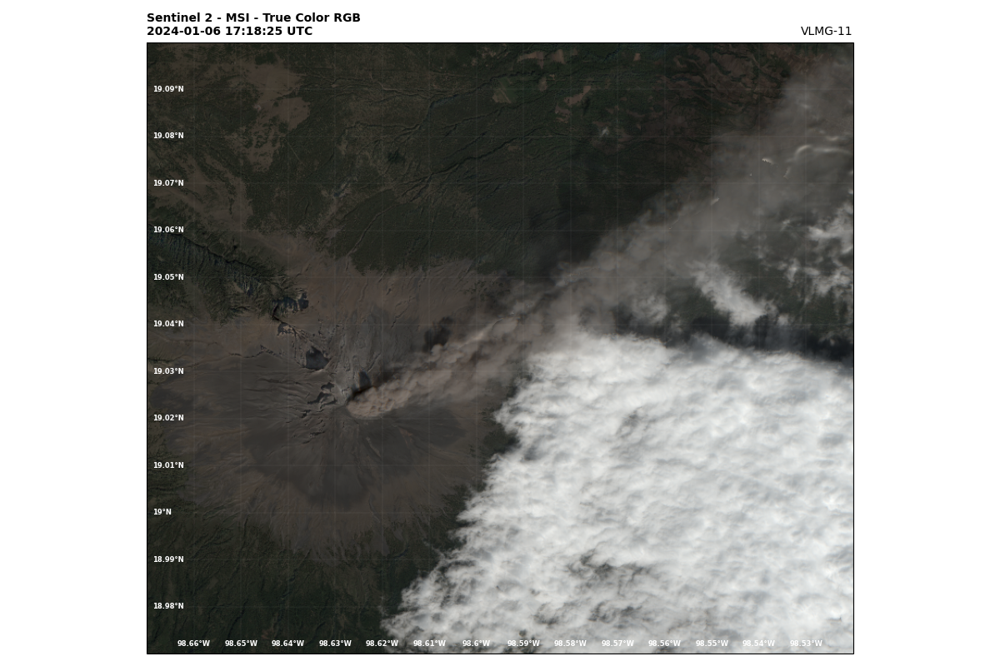

In [72]:
# change these variables as needed
date = '2024-01-06'
min_lon = -98.67; max_lon = -98.52
min_lat = 18.97 ; max_lat = 19.10

# call the function to download visualize the true color composite (there's no need to change this)
plot_sentinel2_true_color(date_sat=date, extent=[min_lon, min_lat, max_lon, max_lat], resample_factor=2, grid_color='white', grid_spacing=0.01, figsize=[12,8])

# **Example 2: Popocatépetl Volcano Eruption (Jan 06th 2024) - Individual MSI Bands**

With the **"plot_sentinel2_msi_band"** function, we can download and visualize a single MSI band for the specified region and date.


**Sentinel-2 Bands and Central Wavelenghts**:

**Reference**: https://www.satimagingcorp.com/satellite-sensors/other-satellite-sensors/sentinel-2a/


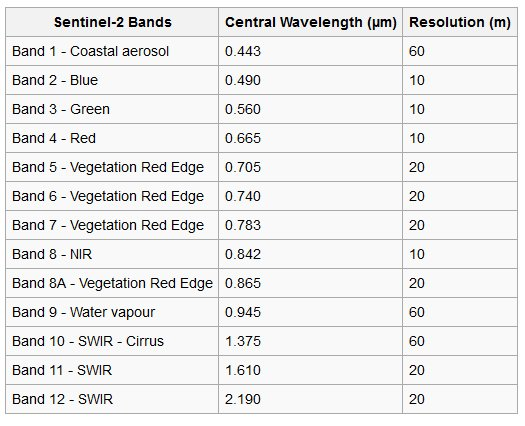

**Plotting the Relative Spectral Response using PySpectral (just an extra!)**

With the function **"plot_relative_spectral_response"** we can check the Relative Spectral Response of many satellite sensors supported by PySpectral. List of supported sensors: https://pyspectral.readthedocs.io/en/master/platforms_supported.html

**Note:**
- This is an interactive plot, you may zoom in and zoom out on any part of the graph.
- You can easily switch to 'GOES-16' and 'abi' for example. Give it a try! :)

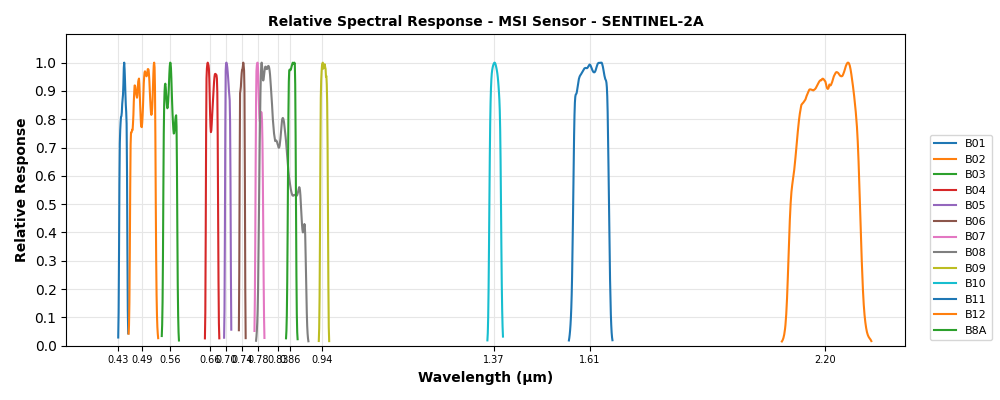

In [68]:
plot_relative_spectral_response(satellite='Sentinel-2A', sensor='msi')

**Let's plot one of the MSI bands using the "plot_sentinel2_msi_band" function:**


**Notes:**
- You can easily customize your plot by changing the **"colormap"** and **"msi_band"** variables.
- After running the function, you can hover your mouse over the generated image to inspect the coordinates and Reflectance values.

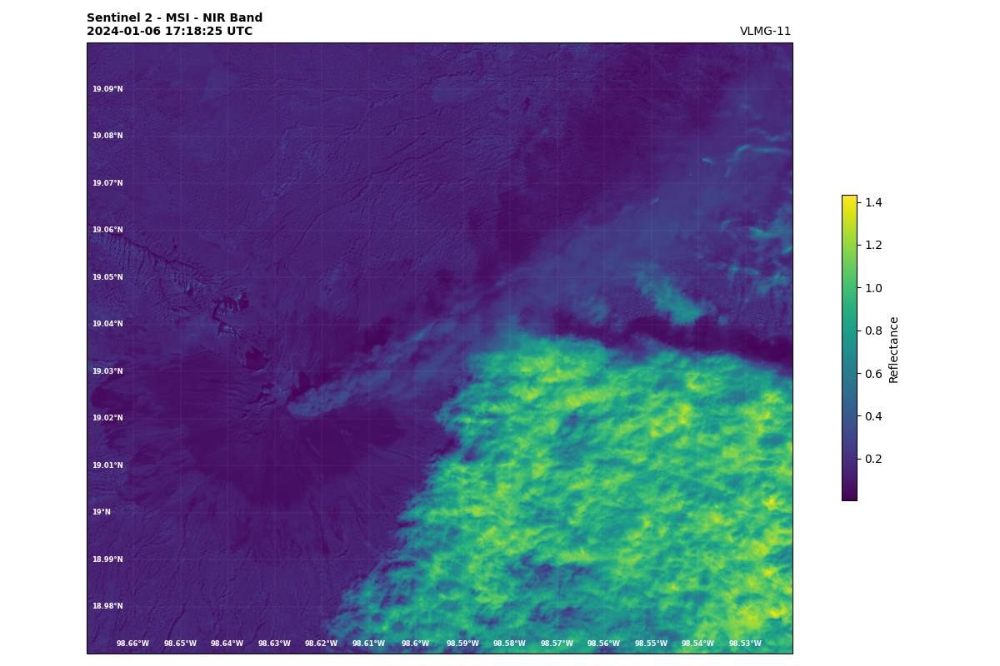

In [73]:
# change these variables as needed
date = '2024-01-06'
min_lon = -98.67; max_lon = -98.52
min_lat = 18.97 ; max_lat = 19.10

colormap = 'viridis'
# list of python colormaps: https://matplotlib.org/stable/users/explain/colors/colormaps.html

msi_band = 'nir'
# 'msi_band' variable options:
# 'coastal' (Coastal aerosol) | 'blue' (Blue) | 'green' (Green) | 'red' (Red) | 'rededge1' (Red-edge) | 'rededge2' (Red-edge)
# 'rededge3' (Red-edge) | 'nir' (Near-infrared) | 'nir08' (Narrow NIR) | 'nir09' (Water vapor) | 'swir16' (SWIR) | 'swir22' (SWIR)

# call the function to download visualize the msi band (there's no need to change this)
plot_sentinel2_msi_band(date_sat=date, extent=[min_lon, min_lat, max_lon, max_lat], resample_factor=2, grid_color='white', grid_spacing=0.01, figsize=[12,8], cmap=colormap, band=msi_band)

# **Example 3: Downloading an MSI Band and Working with Python**

Using the **"download_sentinel2_msi_band"** function, we can download a single MSI band for the specified region and date.

**Note:** When running the function, the 2D data array (reflectances) will be stored in the assigned variable (default is "data").

In [70]:
# change these variables as needed
date = '2024-01-06'
min_lon = -98.67 ; max_lon = -98.52
min_lat = 18.97  ; max_lat = 19.10

msi_band = 'nir'
# 'msi_band' variable options:
# 'coastal' (Coastal aerosol) | 'blue' (Blue) | 'green' (Green) | 'red' (Red) | 'rededge1' (Red-edge) | 'rededge2' (Red-edge)
# 'rededge3' (Red-edge) | 'nir' (Near-infrared) | 'nir08' (Narrow NIR) | 'nir09' (Water vapor) | 'swir16' (SWIR) | 'swir22' (SWIR)

# call the function to download the msi band (there's no need to change this)
data = download_sentinel2_msi_band(date_sat=date, extent=[min_lon, min_lat, max_lon, max_lat], resample_factor=2, band=msi_band)

You may check the characteristics of this dataset with the Xarray library:

In [71]:
# check the metadata
data

<xarray.DataArray 'nir' (y: 722, x: 791)> Size: 5MB
dask.array<truediv, shape=(722, 791), dtype=float64, chunksize=(722, 791), chunktype=numpy.ndarray>
Coordinates:
  * y            (y) float64 6kB 2.112e+06 2.112e+06 ... 2.098e+06 2.098e+06
  * x            (x) float64 6kB 5.347e+05 5.347e+05 ... 5.505e+05 5.505e+05
    spatial_ref  int32 4B 32614
    time         datetime64[ns] 8B 2024-01-06T17:18:25.396000

Now, we can process the data as needed using Python!

**Note**: After running the script, you can hover your mouse over the generated image to inspect Reflectance values.

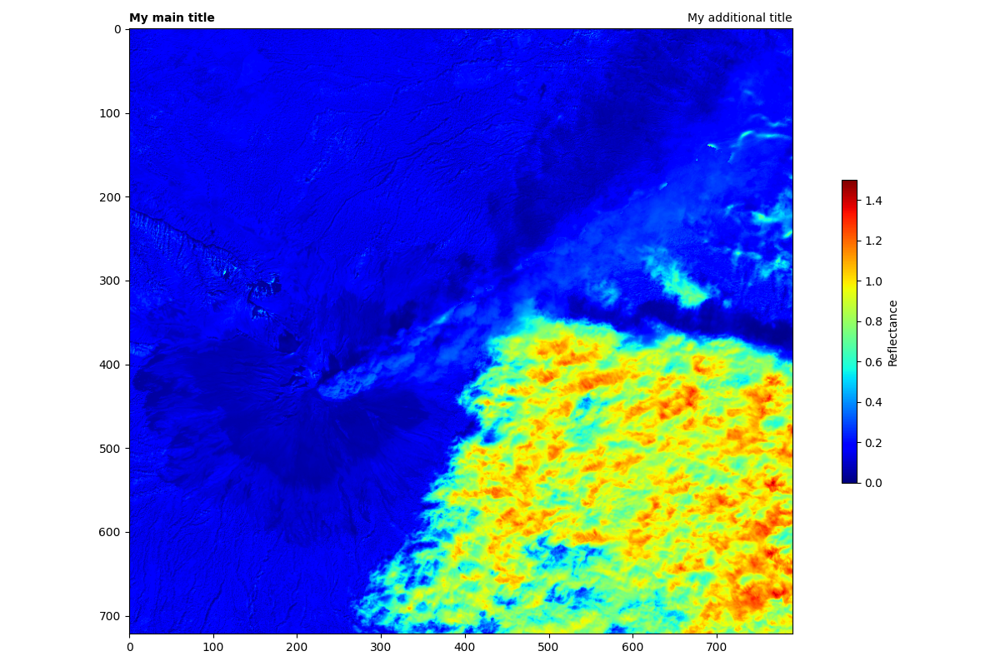

In [74]:
import matplotlib.pyplot as plt  # import matplotlib

# clear the previous figure to ensure no plots persist between cells
plt.close()

# create a new figure and axis with a specified size (width x height, in inches)
fig, ax = plt.subplots(figsize=[12,8])

# display the dataset using imshow with specified colormap and value limits
cax = ax.imshow(data, cmap='jet', vmin=0, vmax=1.5)

# add a main title and an additional title, positioned on the left and right respectively
ax.set_title('My main title', fontweight='bold', fontsize=10, loc='left')
ax.set_title('My additional title', fontweight='normal', fontsize=10, loc='right')

# add a colorbar with orientation and label
fig.colorbar(cax, ax=ax, orientation='vertical', label='Reflectance', shrink=0.5)

# use tight_layout to automatically adjust subplot parameters for optimal spacing
plt.tight_layout()

# show the plot
plt.show()

# **Example 4: Island Before and After Hunga Tonga Eruption**

The **Hunga Tonga** eruption, which occurred on **January 15, 2022**, was one of the most powerful volcanic events in recent history. The eruption originated from the **Hunga Tonga-Hunga Ha'apai** volcano, located in the South Pacific Ocean, near the Kingdom of Tonga. It was an underwater eruption that produced massive explosions, a significant tsunami, and widespread ash clouds.

**Note:** Given the big size of these images, for a resample factor of "1" (maximum resolution), it is recommended a maximum size of 0.5 x 0.5 so that Colab doesn't crash. For bigger resample factors (less resolution), you may visualize a bigger region.

**4.1: Island Before Eruption**

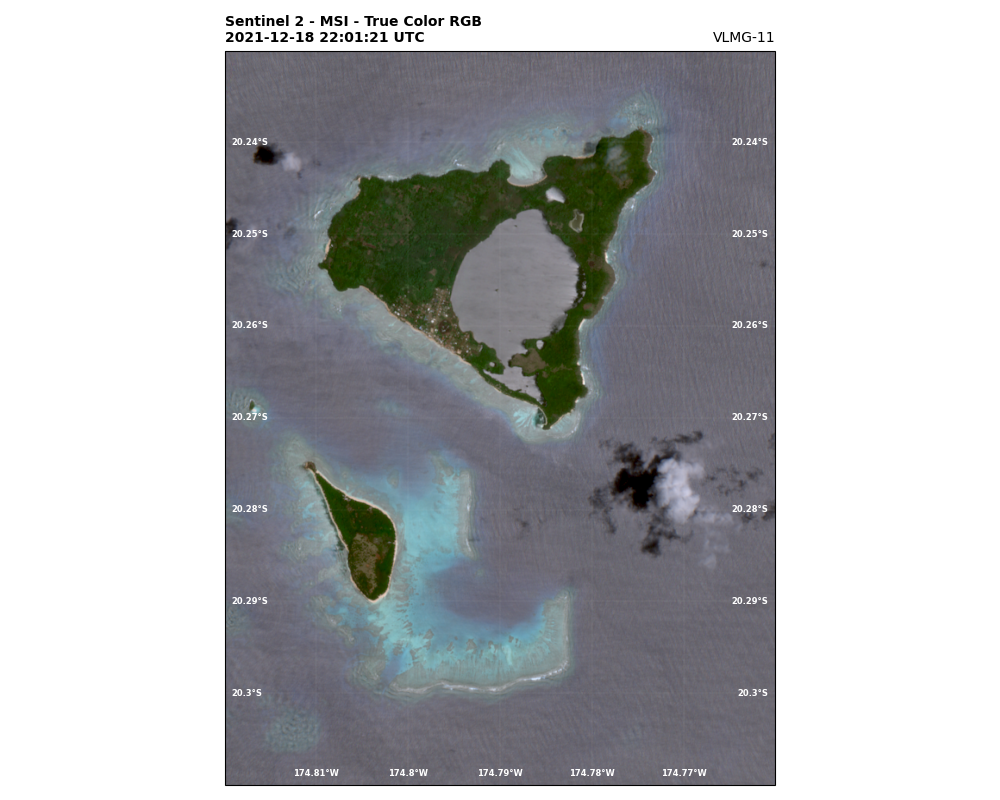

In [108]:
# change these variables as needed
date = '2021-12-18'
min_lon = -174.82; max_lon = -174.76
min_lat = -20.31 ; max_lat = -20.23

# call the function to download visualize the true color composite (there's no need to change this)
plot_sentinel2_true_color(date_sat=date, extent=[min_lon, min_lat, max_lon, max_lat], resample_factor=1, grid_color='white', grid_spacing=0.01, figsize=[10,8])

**4.2: Island After Eruption**

We may search for a date after January 15, 2022, using the **"check_sentinel2_dates"** function.

In [109]:
# change these variables as needed
month = '2022-01'
min_lon = -174.82; max_lon = -174.76
min_lat = -20.31 ; max_lat = -20.23

# call the function to check the available dates
check_sentinel2_dates(month=month, extent=[min_lon, min_lat, max_lon, max_lat])

Available passes for the selected region and month:
2022-01-02T22:01:28.699000000
2022-01-04T21:51:27.815000000
2022-01-07T22:01:23.103000000
2022-01-09T21:51:33.041000000
2022-01-12T22:01:28.058000000
2022-01-14T21:51:27.512000000
2022-01-17T22:01:22.530000000
2022-01-19T21:51:31.754000000
2022-01-22T22:01:27.031000000
2022-01-24T21:51:26.091000000
2022-01-27T22:01:20.805000000
2022-01-29T21:51:31.829000000


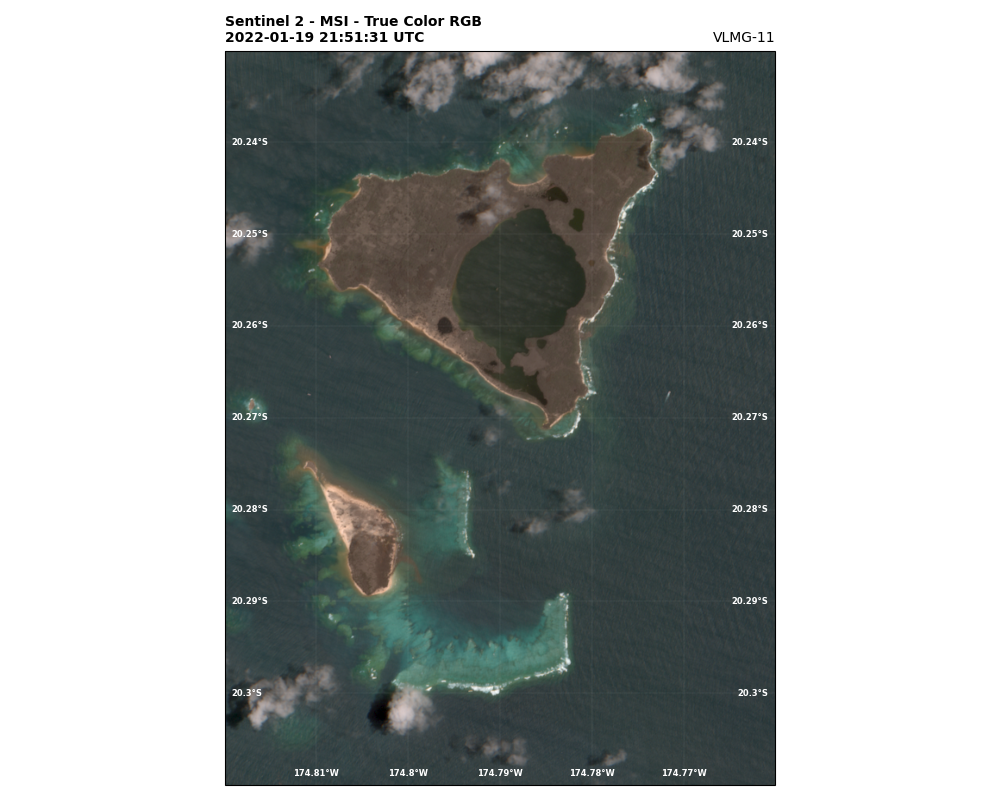

In [114]:
# change these variables as needed
date = '2022-01-19'
min_lon = -174.82; max_lon = -174.76
min_lat = -20.31 ; max_lat = -20.23

# call the function to download visualize the true color composite (there's no need to change this)
plot_sentinel2_true_color(date_sat=date, extent=[min_lon, min_lat, max_lon, max_lat], resample_factor=1, grid_color='white', grid_spacing=0.01, figsize=[10,8])

# **Example 5: Mar Chiquita (Visualizing a Bigger Region)**

Mar Chiquita is a large coastal lagoon and nature reserve located in the central region of Argentina, specifically in the province of Buenos Aires. It is one of the largest saline lagoons in Argentina, covering an area of approximately 3,500 square kilometers.

**Note:** This example is intended to demonstrate how you can plot larger areas (we suggest a max of 0.5 x 0.5 degrees, increasing the **resample_factor** and the **grid_spacing** variables).

In [116]:
# change these variables as needed
month = '2022-07'
min_lon = -63.50; max_lon = -62.00
min_lat = -31.00; max_lat = -29.50

# call the function to check the available dates (there's no need to change this)
check_sentinel2_dates(month=month, extent=[min_lon, min_lat, max_lon, max_lat])

Available passes for the selected region and month:
2022-07-03T14:21:05.327000000
2022-07-05T14:11:19.791000000
2022-07-08T14:20:57.051000000
2022-07-10T14:11:27.670000000
2022-07-13T14:21:04.919000000
2022-07-15T14:11:19.299000000
2022-07-18T14:20:57.022000000
2022-07-20T14:11:26.412000000
2022-07-23T14:21:03.020000000
2022-07-25T14:11:19.861000000
2022-07-28T14:20:57.213000000
2022-07-30T14:11:35.654000000


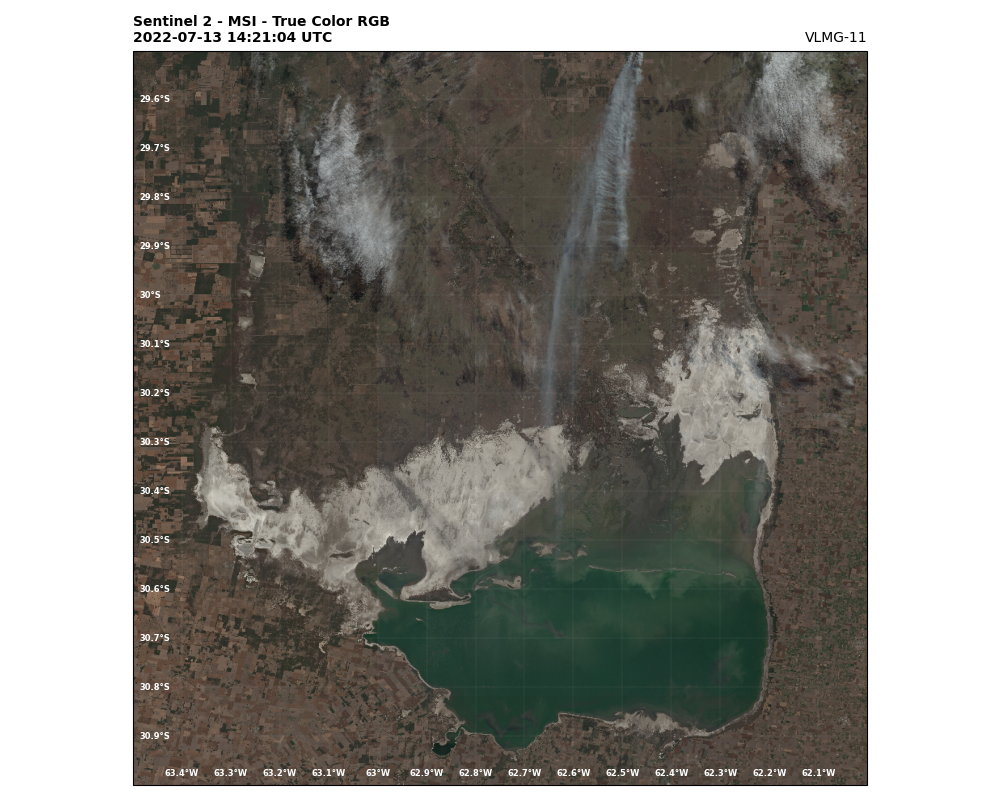

In [9]:
# change these variables as needed
date = '2022-07-13'
min_lon = -63.50; max_lon = -62.00
min_lat = -31.00; max_lat = -29.50

# call the function to download visualize the true color composite
plot_sentinel2_true_color(date_sat=date, extent=[min_lon, min_lat, max_lon, max_lat], resample_factor=16, grid_color='white', grid_spacing=0.1, figsize=[10,8])

# **Accessing and Processing SENTINEL-2 Images With Python and Google Colab**


**Author:** Diego Souza (https://github.com/diegormsouza/vlmg-11/) - INPE / CGCT / DISSM (VLab CoE Brazil)

**Contributors:** Marcial Garbanzo (UCR - VLab CoE Costa Rica) / Inés Leyba (DCAO - VLab CoE Argentina)

**References:**

https://stacspec.org/en/tutorials/access-sentinel-2-data-aws/

https://gist.github.com/alexgleith/dc49156aab4b9270b0a0f145bd7fa0ce

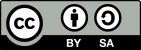